In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage import io, color, transform, feature
import matplotlib.pyplot as plt
%matplotlib inline

## read and describe the metadata

In [2]:
fpn_csv = 'cluster_images.csv'
data = pd.read_csv(fpn_csv, encoding='ISO-8859-1')

In [3]:
# get column names
list(data)

['s_no',
 'artist',
 'title',
 'art_movement',
 'museum_venue',
 'country_of_origin',
 'has_text',
 'primary_medium',
 'medium',
 'work_size',
 'date',
 'representation',
 'representation_semi',
 'kinetic',
 'map',
 'map2',
 'spatial_dimension',
 'spatial_dimension2',
 'pl',
 'si',
 'va',
 'te',
 'co',
 'or',
 'sh',
 'reflection',
 'po',
 'li',
 'ar',
 'notes']

In [4]:
data.head()

,s_no,artist,title,art_movement,museum_venue,country_of_origin,has_text,primary_medium,medium,work_size,...,va,te,co,or,sh,reflection,po,li,ar,notes
0,2,Giorgio de Chirico,The Uncertainty of the Poet,surrealism,Tate,Italy,False,painting,"painting, oil on canvas",106 x 94 cm,...,3,0,0,4,3,False,0,0,5,"distorted perspective, shadow, signification o..."
1,3,Giovanni Anselmo,Direction,arte povera,Tate,Italy,False,sculpture,"sculpture, fabric, glass & metal",24 x 420 x 335 cm,...,1,3,0,3,2,False,0,0,5,"hard to understand the viewpoint, sense of for..."
2,4,Milton Avery,Yellow Sky,modernism,Tate,America,False,painting,"painting, oil on canvas",156 x 184 cm,...,2,4,4,2,4,False,0,0,5,"flatish, textured shapes & specific colors-lin..."
3,5,Gillian Avery,Distillation,abstraction,Tate,UK,False,painting,"painting, oil, household paint on hardboard",213 x 152 cm,...,1,2,0,2,4,False,0,0,5,"shapes, layers, paint handlng/texture, orienta..."
4,6,Joseph (Jef) Banc,Pair-Bearing Matrix,abstraction,Tate,France,False,painting,"painting, mixed media on canvas",73 x 60 cm,...,1,4,1,0,4,False,0,0,5,"ambiguity through abstraction, odd shape, v te..."


## create a subset of the columns you will use to fit KMeans

Here, I am **arbitrarily** choosing the seven [visual variables defined by Bertin](https://infovis-wiki.net/wiki/Visual_Variables). Variable descriptions [here](https://github.com/visualizedata/ml/blob/master/ML_assignment_3/option_2/contents-of-cluster_images.csv). 

You should choose the columns that you decide will best define the clusters. You may need to make transformations on existing variables. 

In [5]:
# X = data[['pl', 'si', 'va', 'te', 'co', 'or', 'sh']]
X = data[['primary_medium', 'art_movement', 'representation_semi', 'spatial_dimension']]

In [6]:
X.head()

,primary_medium,art_movement,representation_semi,spatial_dimension
0,painting,surrealism,False,False
1,sculpture,arte povera,False,True
2,painting,modernism,False,False
3,painting,abstraction,False,False
4,painting,abstraction,False,False


# KMeans

In [7]:
from sklearn.cluster import KMeans

In [8]:
print(X.dtypes)

primary_medium         object
art_movement           object
representation_semi      bool
spatial_dimension        bool
dtype: object


In [9]:
print(X.columns)

Index(['primary_medium', 'art_movement', 'representation_semi',
       'spatial_dimension'],
      dtype='object')


In [10]:
import warnings
from sklearn.cluster import KMeans

# Suppress future warnings
warnings.simplefilter(action='ignore', category=FutureWarning)


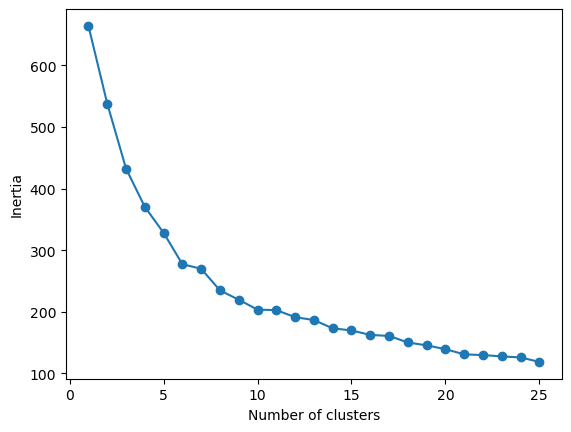

In [11]:
X = pd.get_dummies(X)  # For one-hot encoding


# first attempt at fitting K means to view change in Inertia
from sklearn.cluster import KMeans

# container to store inertia scores over iterations
distortions = []

# fit KMeans iteratively to begin to assess the appropriate number of clusters
for i in range(1, 26):
    km = KMeans(n_clusters=i)
    km.fit(X)
    distortions.append(km.inertia_)
    
# vizualize change in inertia
plt.plot(range(1, 26), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

## plot inertia scores by number of clusters

In [12]:
import warnings
from sklearn.exceptions import ConvergenceWarning

# Suppress ConvergenceWarnings
warnings.simplefilter("ignore", ConvergenceWarning)

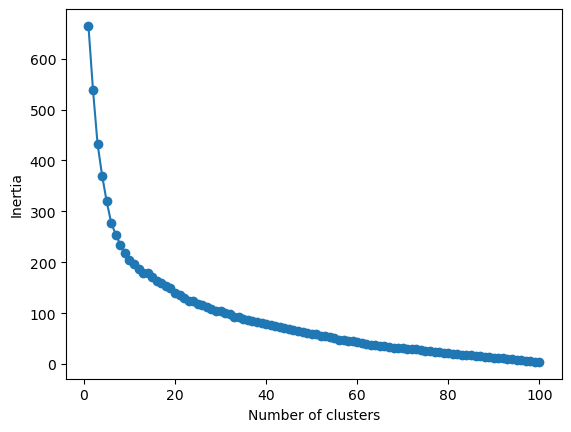

In [13]:
X = pd.get_dummies(X)  # For one-hot encoding

# first attempt at fitting K means to view change in Inertia

# container to store inertia scores over iterations
distortions = []

# fit KMeans iteratively to begin to assess the appropriate number of clusters
for i in range(1, 101):
    km = KMeans(n_clusters=i)
    km.fit(X)
    distortions.append(km.inertia_)
    
# vizualize change in inertia
plt.plot(range(1, 101), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

## create silhouette plots to assess various specifications for `n_clusters` in `KMeans`

In [14]:
# modify this list to include the numbers of clusters you want to see
# I have *arbitrarily* chosen these values
range_n_clusters = [4, 5, 10, 15, 20, 21, 22, 23, 24, 25]

For n_clusters = 4 The average silhouette_score is : 0.331471300318697


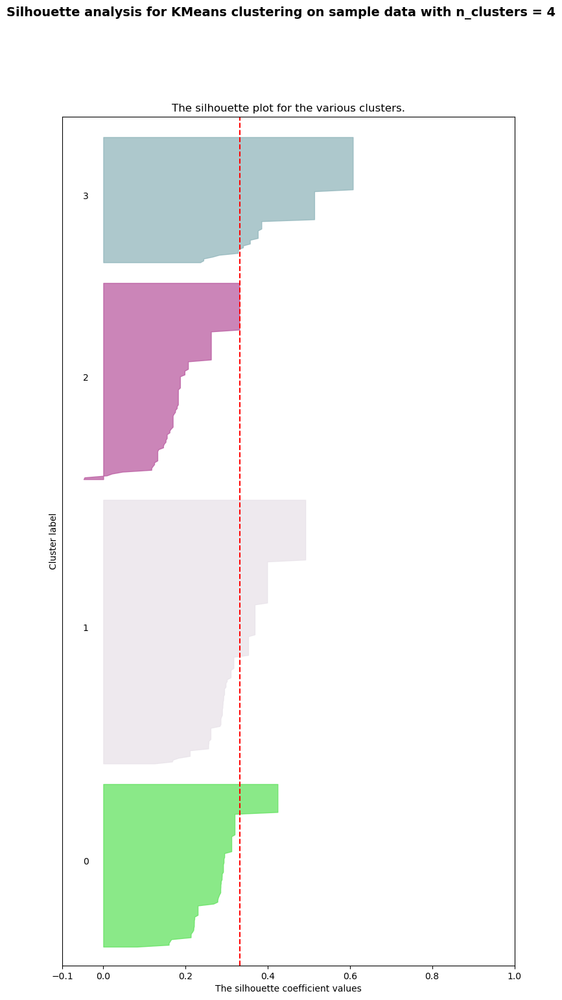

For n_clusters = 5 The average silhouette_score is : 0.38471688598400405


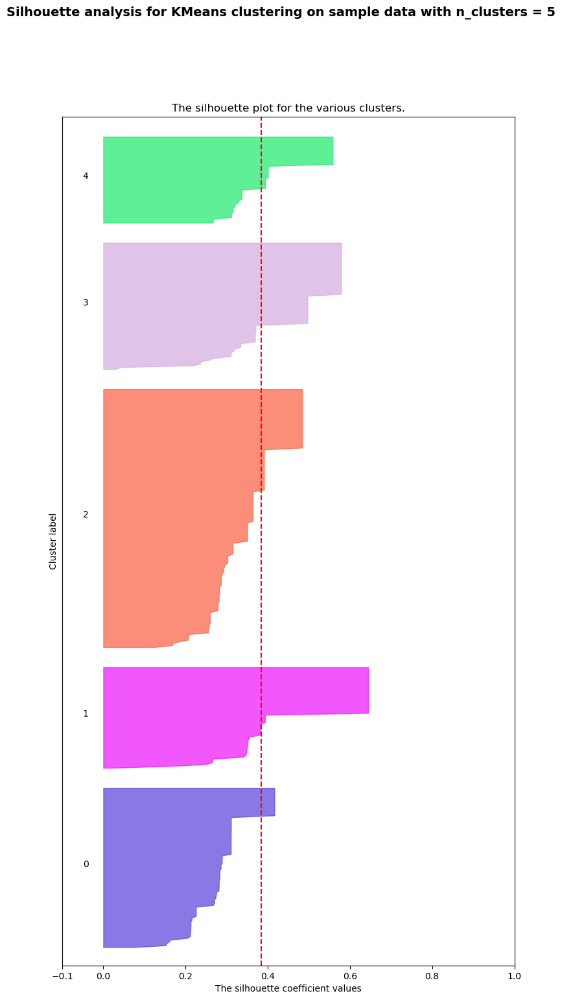

For n_clusters = 10 The average silhouette_score is : 0.4155882724464732


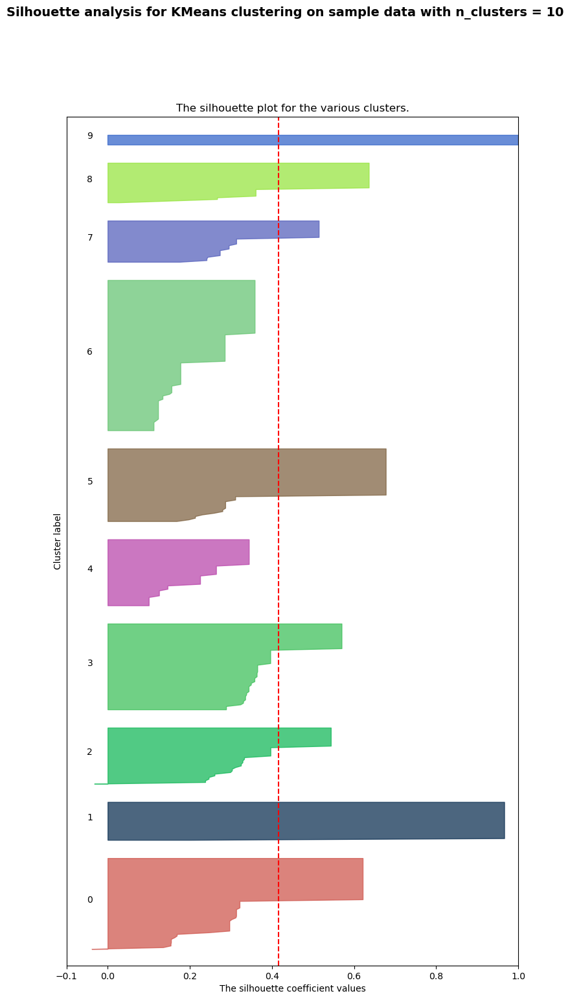

For n_clusters = 15 The average silhouette_score is : 0.44705465644480835


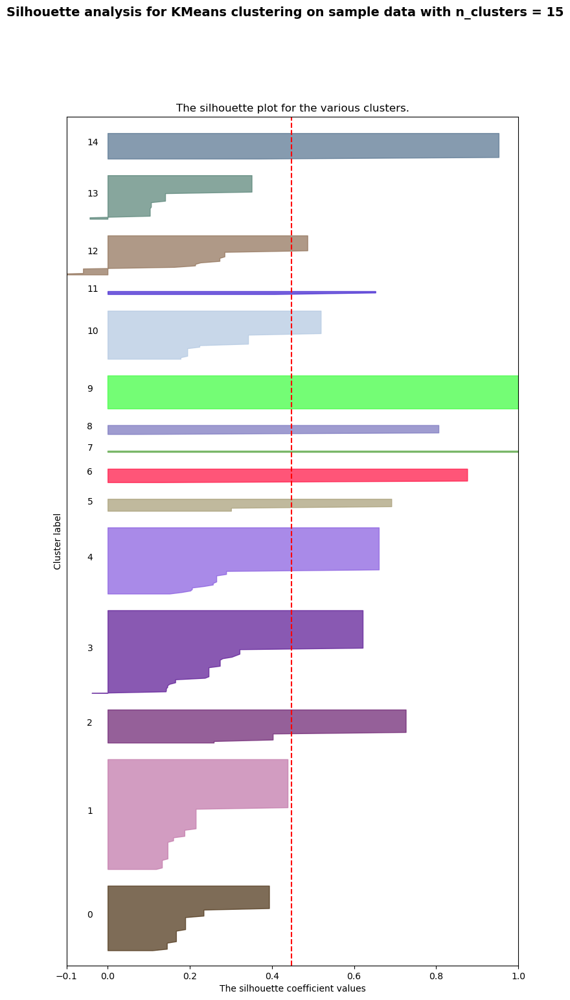

For n_clusters = 20 The average silhouette_score is : 0.5149302129155914


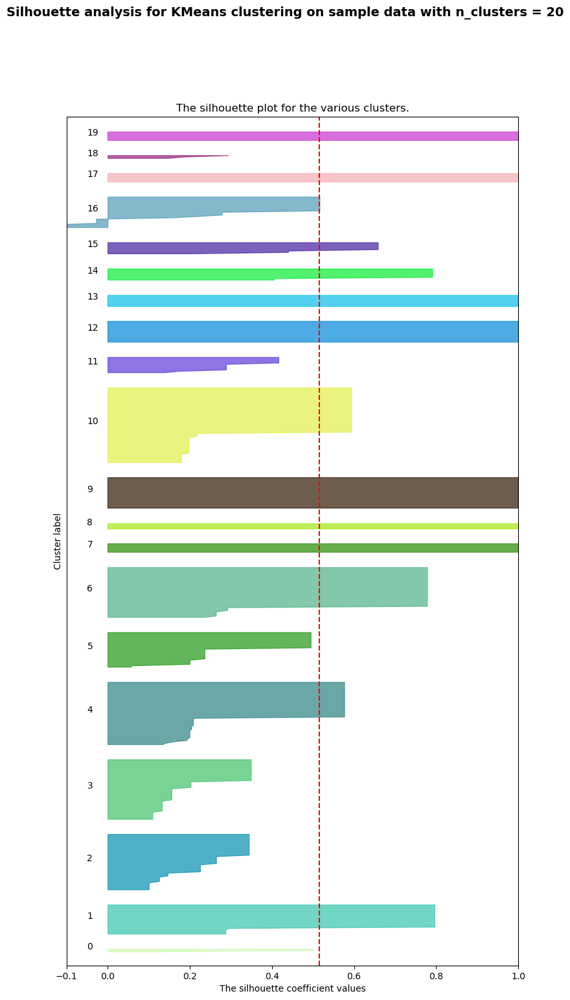

For n_clusters = 21 The average silhouette_score is : 0.5559250327781432


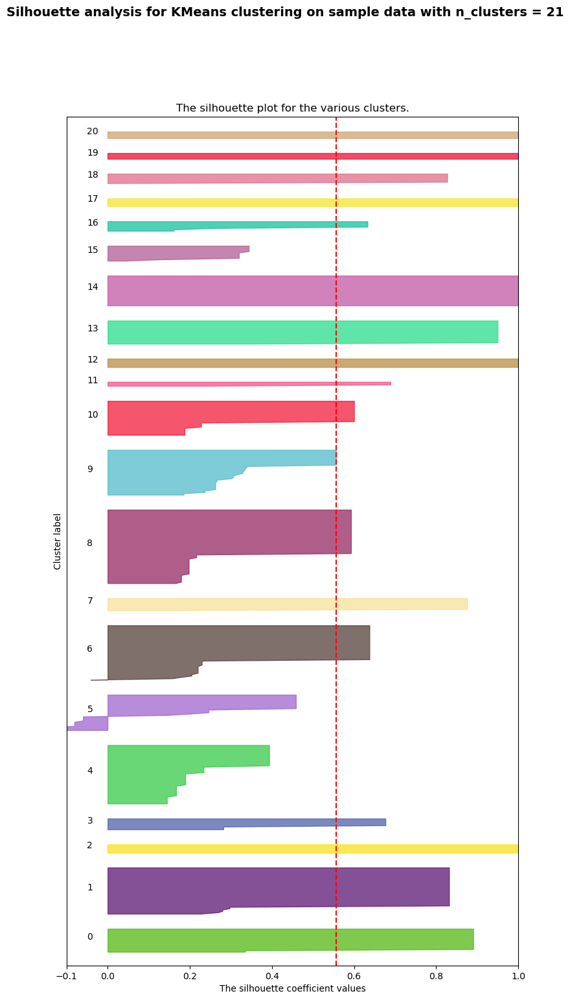

For n_clusters = 22 The average silhouette_score is : 0.5511143269041215


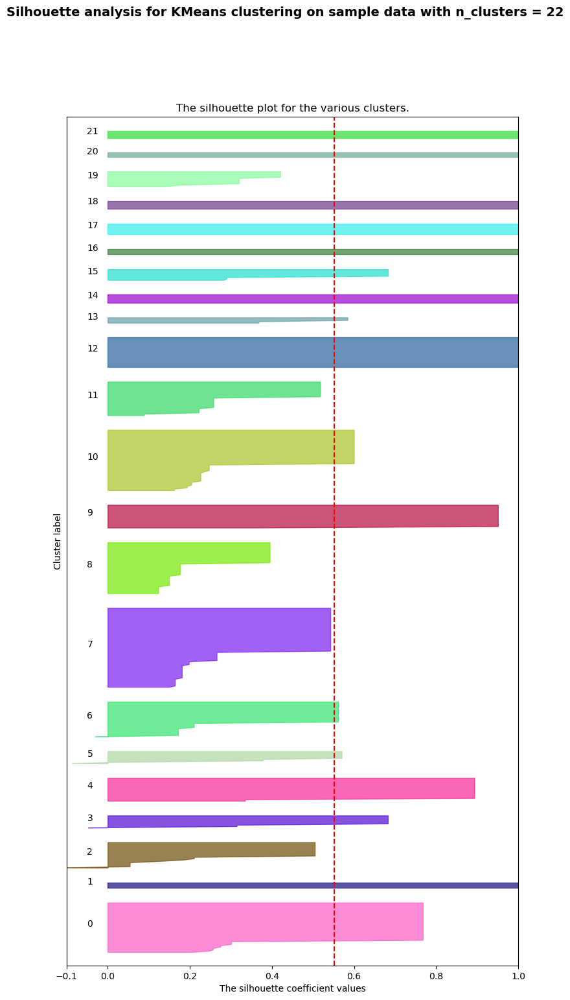

For n_clusters = 23 The average silhouette_score is : 0.5470872158767455


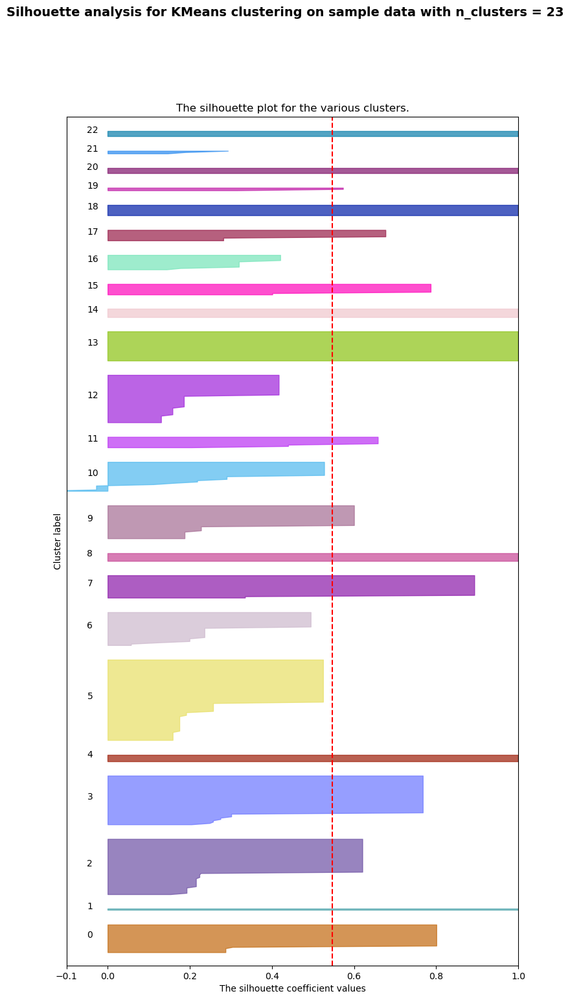

For n_clusters = 24 The average silhouette_score is : 0.5754485795063237


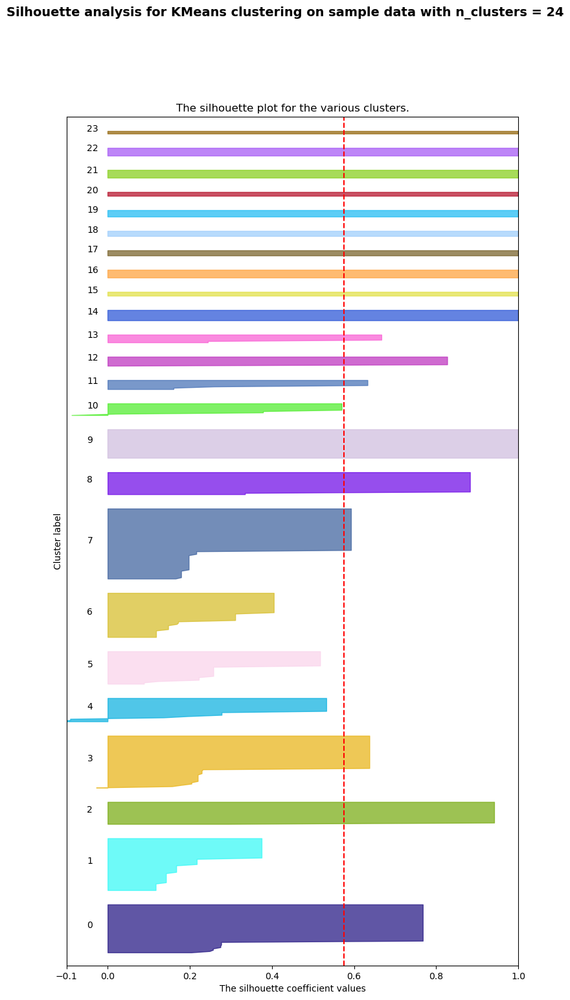

For n_clusters = 25 The average silhouette_score is : 0.5731885216342569


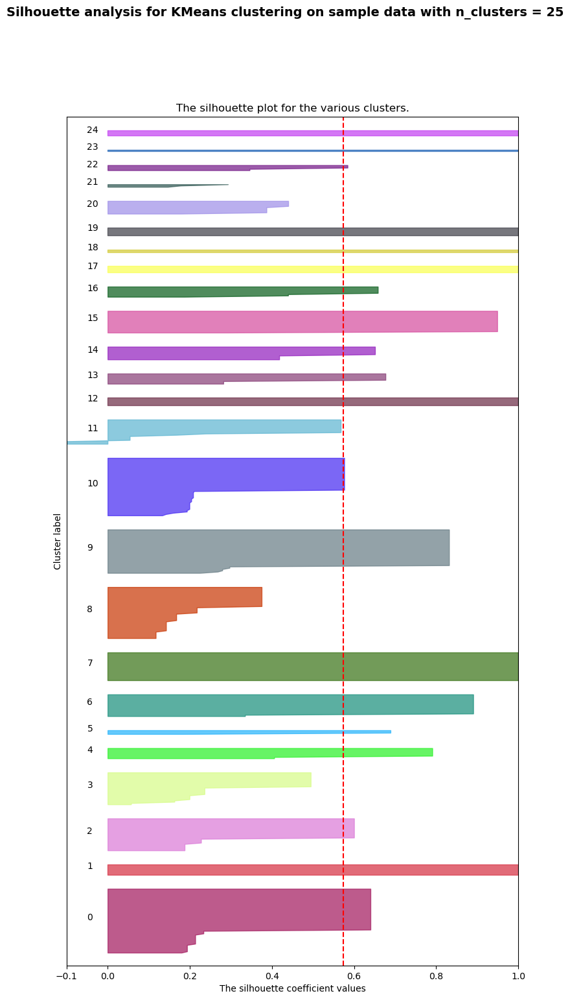

In [15]:
# modified from: http://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html

from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm
import random

for n_clusters in range_n_clusters:
    # Create a subplot
    fig, (ax1) = plt.subplots(1, 1)
    fig.set_size_inches(9, 17)

    # The silhouette coefficient can range from -1, 1 but in this example all lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters, "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        # select a random color for this cluster
        r = lambda: random.randint(0,255)
        color = '#%02X%02X%02X' % (r(),r(),r())
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

    plt.show()

## final fit

After you have decided which features to include and the number of clusters you want, fit your final KMeans model. I have **arbitrarily** chosen 5. 

In [16]:
# set the number of clusters in the final model
my_n_clusters = 24

In [17]:
km = KMeans(n_clusters=my_n_clusters)
km.fit(X)

KMeans(n_clusters=24)

## look at results

The key to knowing if you have chosen the right features and clusters: looking at the images in each cluster and deciding whether they seem to belong together. You could extend this starter code to display the images in this notebook, or you may decide to use Python to write an html file/files to view the images by cluster.

In [18]:
# for i in range(0, max(km.labels_)+1):
#     print(" ")
#     print("* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * ")
#     print("Images in cluster: " + str(i))
#     print("* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * ")
#     for j in range(0, len(km.labels_)):
#         if km.labels_[j] == i:
#             image = 'img_small/' + str(j+2) + '_small.jpg'
#             io.imshow(io.imread(image))
#             print("Images in cluster: " + str(i))
#             plt.show()
#             print("Image Index: " + str(j+2))
#             print("Notes:", X.loc[j, 'notes'])

## All images (creates a large notebook)

In [19]:
# import matplotlib.pyplot as plt
# from skimage import io

# # Loop through each cluster
# for i in range(0, max(km.labels_)+1):
#     print("\n* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * ")
#     print("Images in cluster: " + str(i))
#     print("* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * ")
#     for j in range(0, len(km.labels_)):
#         if km.labels_[j] == i:
#             image_path = 'img_small/' + str(j+2) + '_small.jpg'
#             img = io.imread(image_path)
#             plt.imshow(img)
#             plt.show()
#             print("Images in cluster: " + str(i))
#             print("Image Index: " + str(j+2))
# #             print("Art Movement:", data.loc[j, 'art_movement'])
# #             print("Country:", data.loc[j, 'country_of_origin'])
#             print("Primary Medium:", data.loc[j, 'primary_medium'])
#             print("Medium:", data.loc[j, 'medium'])
#             print("Reprsentation:", data.loc[j, 'representation'])
#             print("Reprsentation Semi:", data.loc[j, 'representation_semi'])
#             print("Spatial Dimension:", data.loc[j, 'spatial_dimension'])








## Prints only 5 images per cluster (to ensure notebook size is smaller)



* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 0
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


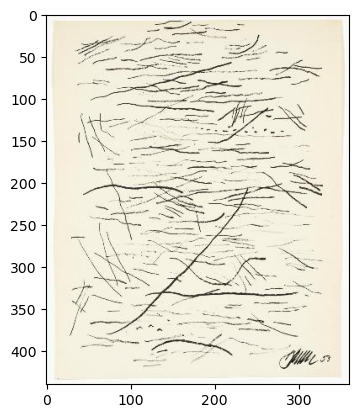

Image Index: 10
Primary Medium: print
Medium: print, lithograph on paper
Representation: False
Representation Semi: False
Spatial Dimension: False


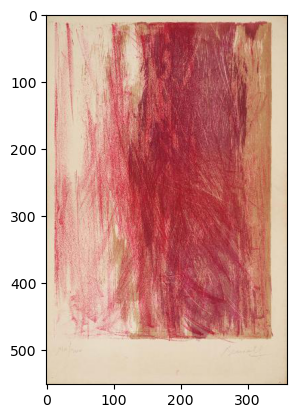

Image Index: 13
Primary Medium: print
Medium: print, lithograph on paper
Representation: False
Representation Semi: False
Spatial Dimension: False


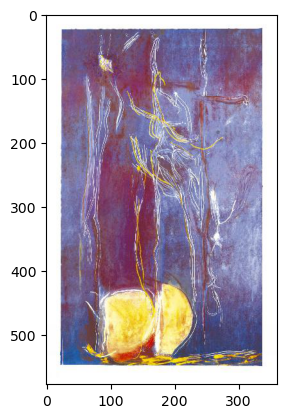

Image Index: 40
Primary Medium: print
Medium: print, lithograph on paper
Representation: False
Representation Semi: False
Spatial Dimension: False


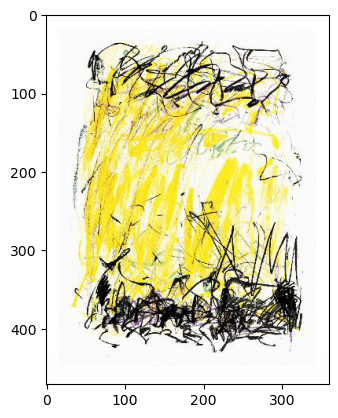

Image Index: 102
Primary Medium: print
Medium: print, lithograph on paper
Representation: False
Representation Semi: False
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 1
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


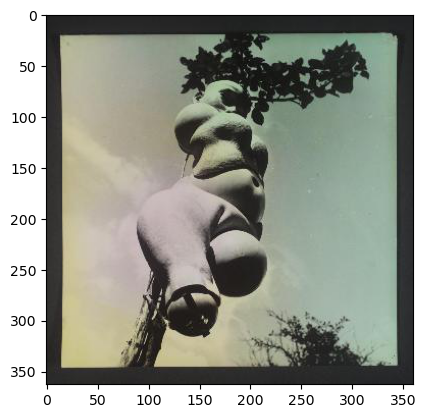

Image Index: 12
Primary Medium: photography
Medium: photo, gelatin silver print on paper
Representation: True
Representation Semi: False
Spatial Dimension: False


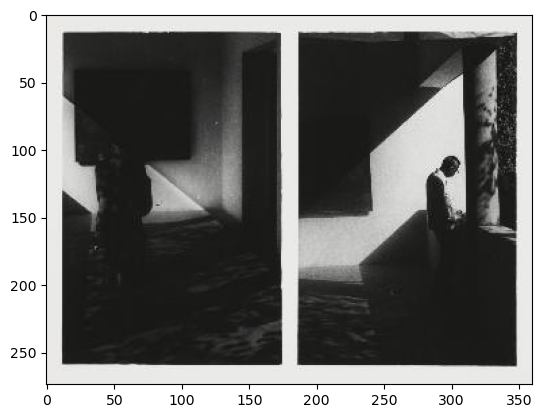

Image Index: 14
Primary Medium: photography
Medium: photo, gelatin silver print on paper
Representation: True
Representation Semi: False
Spatial Dimension: False


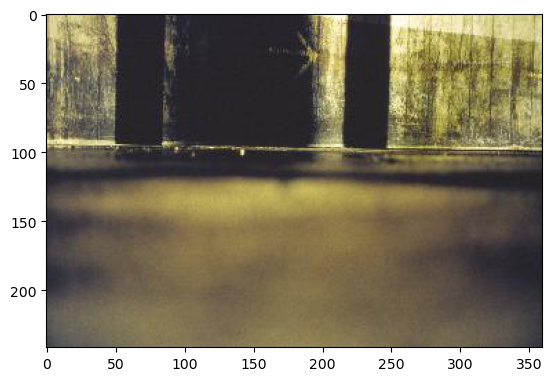

Image Index: 15
Primary Medium: photography
Medium: photo, chromogenic print on paper
Representation: True
Representation Semi: False
Spatial Dimension: False


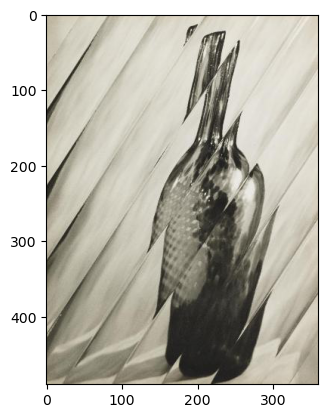

Image Index: 42
Primary Medium: photography
Medium: photo, gelatin silver print on paper
Representation: True
Representation Semi: False
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 2
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


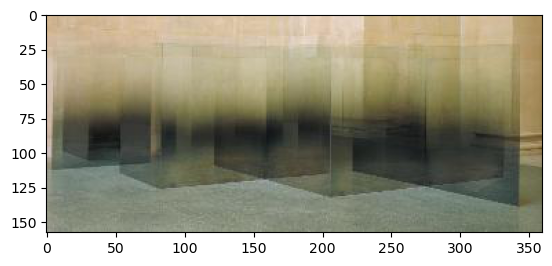

Image Index: 11
Primary Medium: installation
Medium: installation,sculpture, coated glass
Representation: False
Representation Semi: False
Spatial Dimension: True


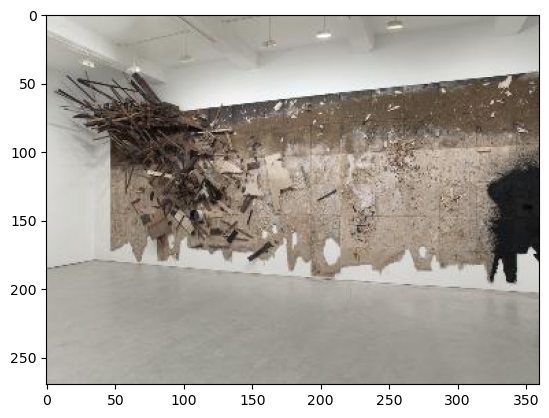

Image Index: 31
Primary Medium: installation
Medium: installation, wood and mixed media
Representation: False
Representation Semi: False
Spatial Dimension: True


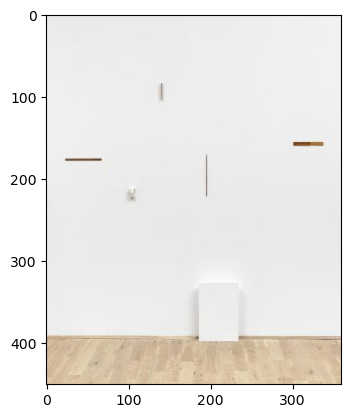

Image Index: 44
Primary Medium: installation
Medium: installation, wood, paint & lacquer
Representation: False
Representation Semi: False
Spatial Dimension: True


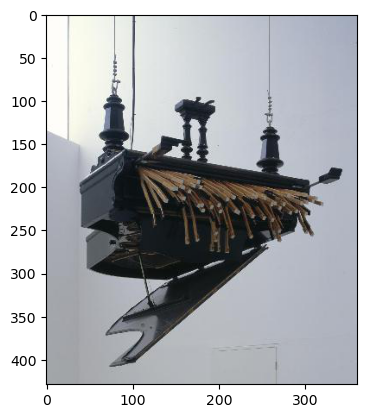

Image Index: 59
Primary Medium: installation
Medium: installation, piano, hydraulic rams & compressor
Representation: True
Representation Semi: False
Spatial Dimension: True

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 3
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


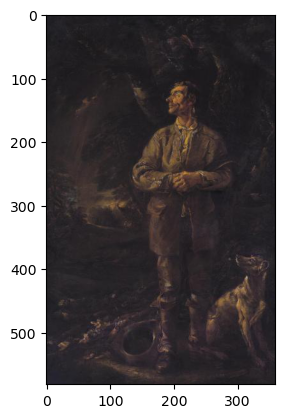

Image Index: 8
Primary Medium: painting
Medium: painting, oil on canvas
Representation: True
Representation Semi: False
Spatial Dimension: False


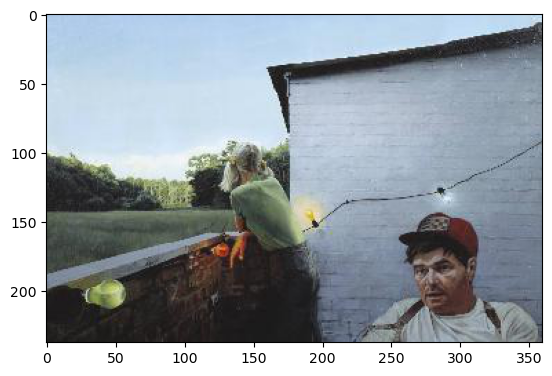

Image Index: 21
Primary Medium: painting
Medium: painting, acrylic on canvas
Representation: True
Representation Semi: False
Spatial Dimension: False


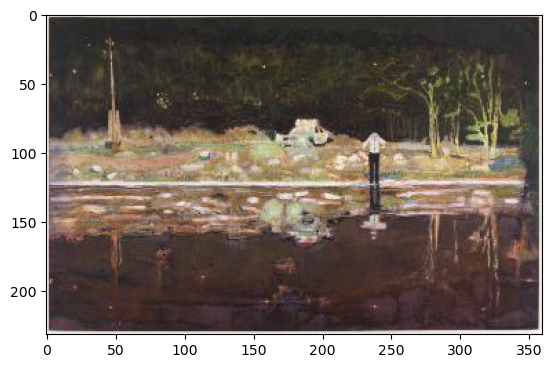

Image Index: 30
Primary Medium: painting
Medium: paint, oil on canvas
Representation: True
Representation Semi: False
Spatial Dimension: False


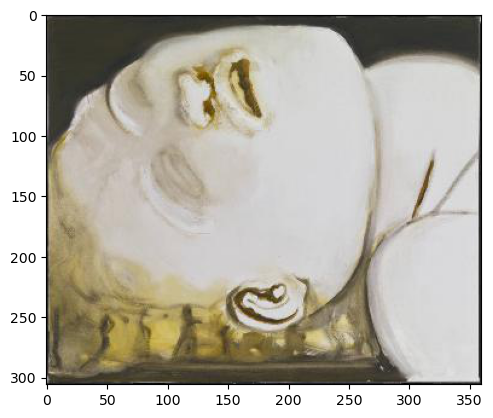

Image Index: 33
Primary Medium: painting
Medium: painting, oil on canvas
Representation: True
Representation Semi: False
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 4
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


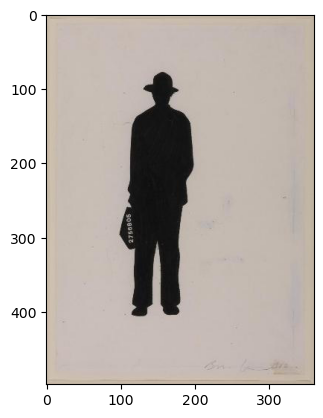

Image Index: 19
Primary Medium: drawing
Medium: drawing, ink on paper
Representation: True
Representation Semi: False
Spatial Dimension: False


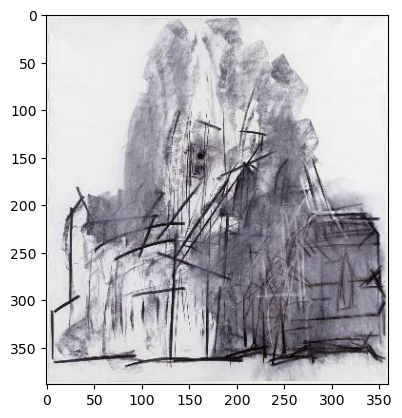

Image Index: 28
Primary Medium: drawing
Medium: drawing, charcoal on paper
Representation: False
Representation Semi: True
Spatial Dimension: False


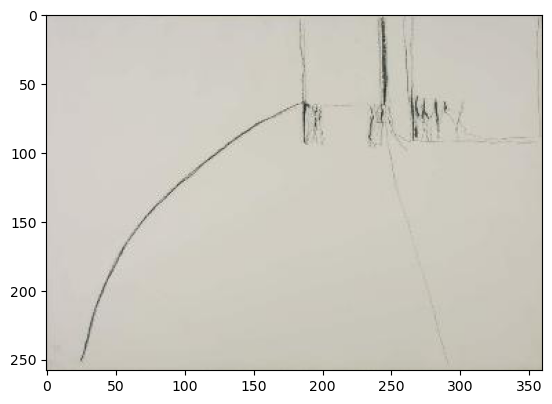

Image Index: 47
Primary Medium: drawing
Medium: drawing, crayon on paper
Representation: False
Representation Semi: False
Spatial Dimension: False


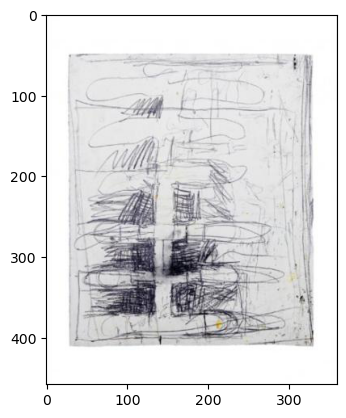

Image Index: 67
Primary Medium: drawing
Medium: drawing, charcoal on paper
Representation: False
Representation Semi: False
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 5
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


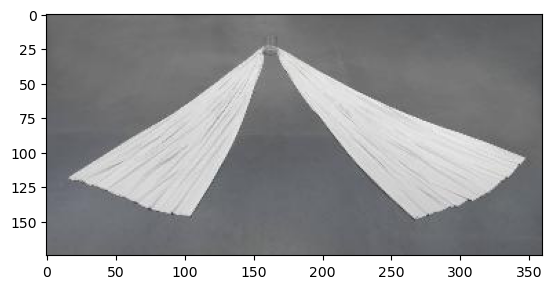

Image Index: 3
Primary Medium: sculpture
Medium: sculpture, fabric, glass & metal
Representation: True
Representation Semi: False
Spatial Dimension: True


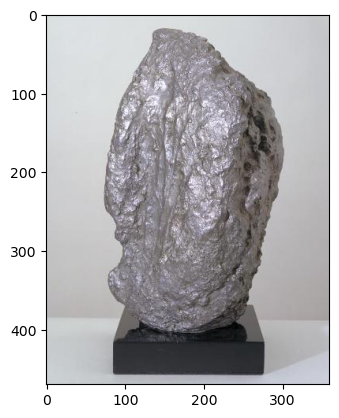

Image Index: 36
Primary Medium: sculpture
Medium: sculpture, lead on marble base
Representation: False
Representation Semi: False
Spatial Dimension: True


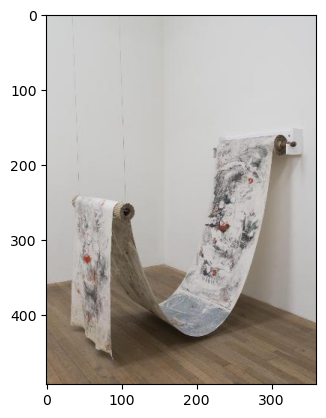

Image Index: 41
Primary Medium: sculpture
Medium: sculpture, monoprinted oil, acrylic, ink on canvas
Representation: False
Representation Semi: False
Spatial Dimension: True


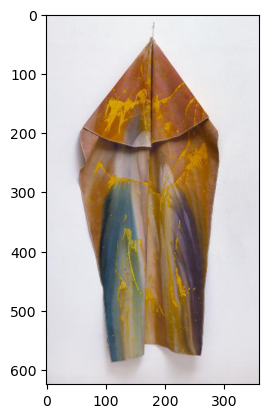

Image Index: 43
Primary Medium: sculpture
Medium: sculpture, acrylic on canvas and leather string
Representation: False
Representation Semi: False
Spatial Dimension: True

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 6
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


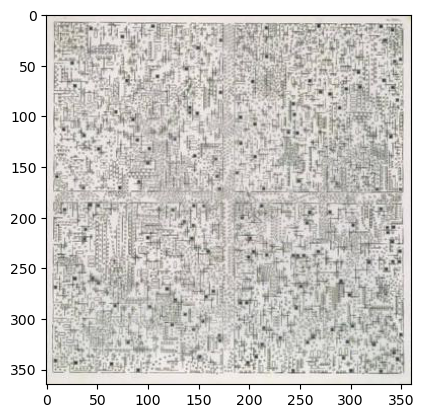

Image Index: 37
Primary Medium: print
Medium: print, blueprint on paper
Representation: False
Representation Semi: False
Spatial Dimension: False


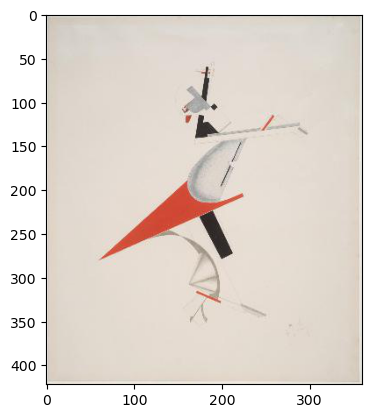

Image Index: 77
Primary Medium: print
Medium: print, lithograph on paper
Representation: False
Representation Semi: False
Spatial Dimension: False


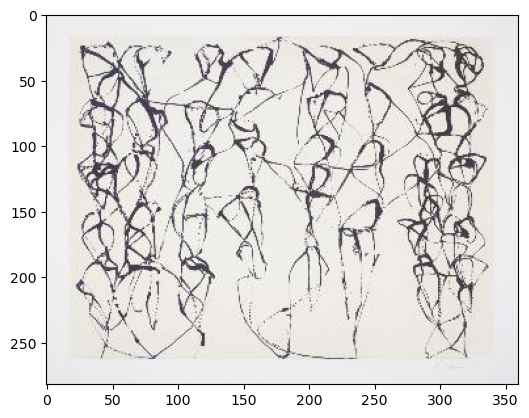

Image Index: 87
Primary Medium: print
Medium: print, etching & aquatint on paper
Representation: False
Representation Semi: False
Spatial Dimension: False


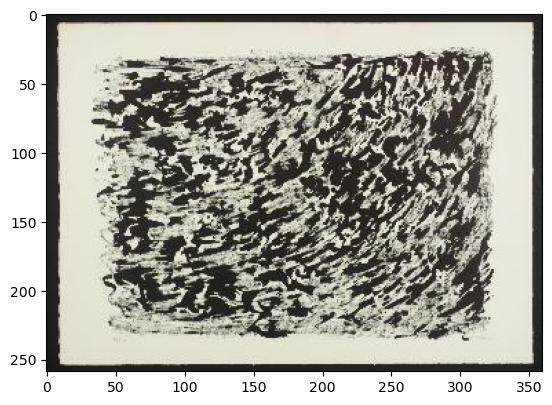

Image Index: 99
Primary Medium: print
Medium: print, lithograph on paper
Representation: False
Representation Semi: False
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 7
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


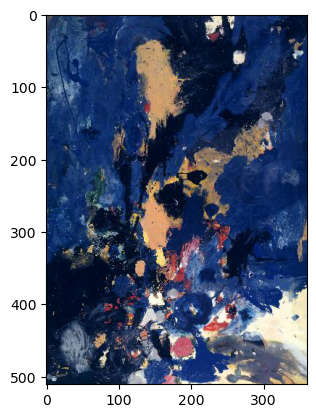

Image Index: 5
Primary Medium: painting
Medium: painting, oil, household paint on hardboard
Representation: False
Representation Semi: False
Spatial Dimension: False


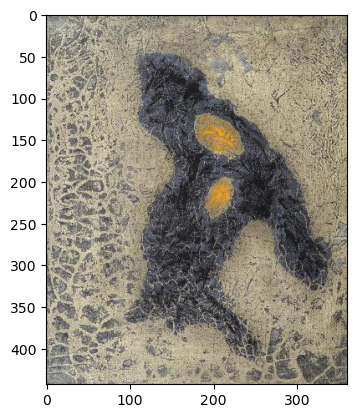

Image Index: 6
Primary Medium: painting
Medium: painting, mixed media on canvas
Representation: False
Representation Semi: False
Spatial Dimension: False


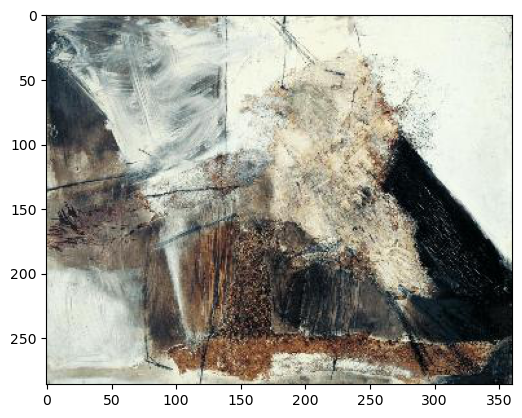

Image Index: 17
Primary Medium: painting
Medium: painting, oil on hardboard
Representation: False
Representation Semi: False
Spatial Dimension: False


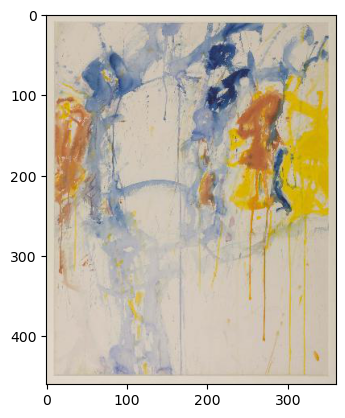

Image Index: 39
Primary Medium: painting
Medium: painting, watercolour on paper
Representation: False
Representation Semi: False
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 8
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


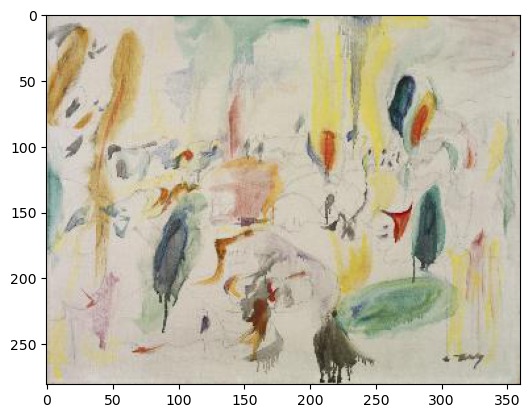

Image Index: 45
Primary Medium: painting
Medium: painting, oil & graphite on canvas
Representation: False
Representation Semi: True
Spatial Dimension: False


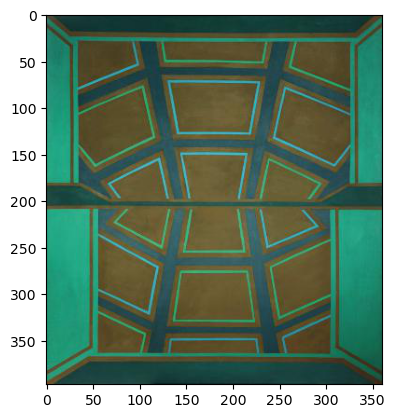

Image Index: 63
Primary Medium: painting
Medium: painting, oil on canvas
Representation: False
Representation Semi: True
Spatial Dimension: False


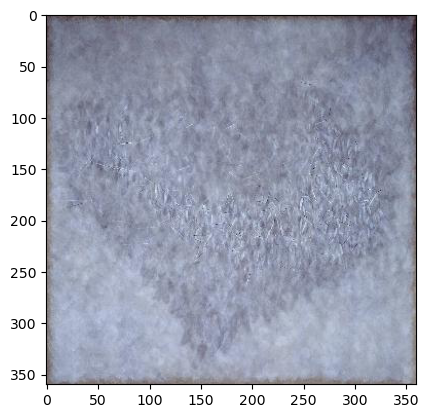

Image Index: 108
Primary Medium: painting
Medium: painting, acrylic paint & chalk on canvas
Representation: False
Representation Semi: True
Spatial Dimension: False


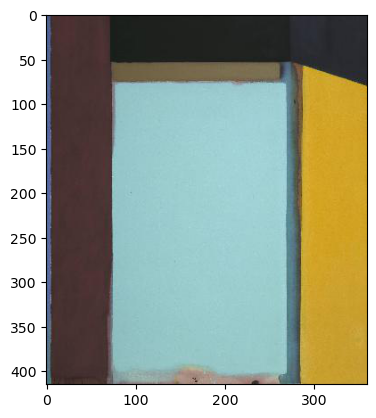

Image Index: 121
Primary Medium: painting
Medium: painting, acrylic on canvas
Representation: False
Representation Semi: True
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 9
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


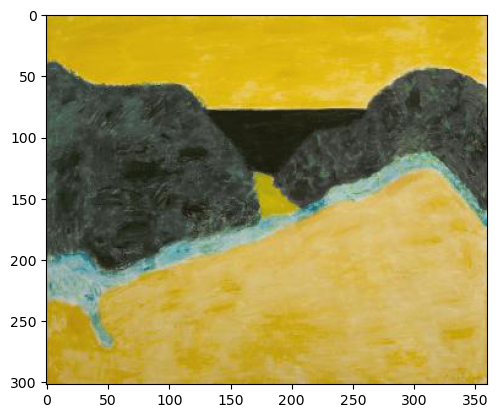

Image Index: 4
Primary Medium: painting
Medium: painting, oil on canvas
Representation: True
Representation Semi: False
Spatial Dimension: False


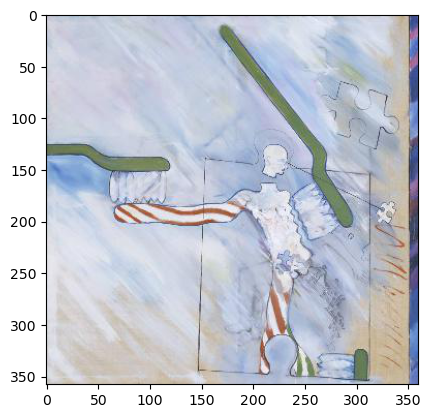

Image Index: 20
Primary Medium: painting
Medium: painting, oil on canvas
Representation: True
Representation Semi: False
Spatial Dimension: False


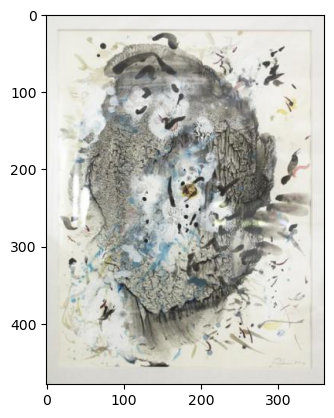

Image Index: 60
Primary Medium: painting
Medium: painting, acrylic on paper
Representation: False
Representation Semi: False
Spatial Dimension: False


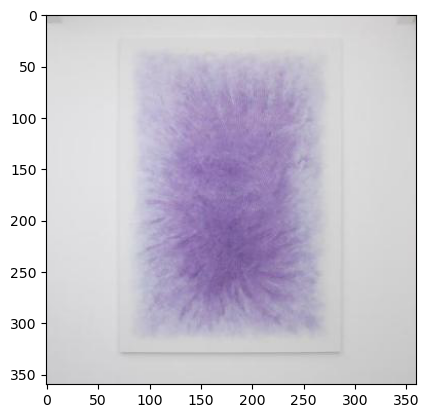

Image Index: 62
Primary Medium: painting
Medium: painting, pencil & aquacryl on canvas & aluminum
Representation: False
Representation Semi: False
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 10
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


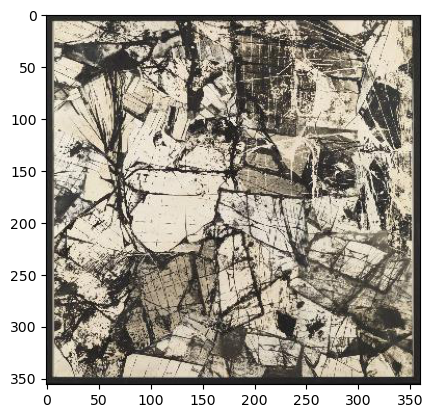

Image Index: 53
Primary Medium: photography
Medium: photo, collage, gelatin silver print & ink on paper
Representation: False
Representation Semi: True
Spatial Dimension: False


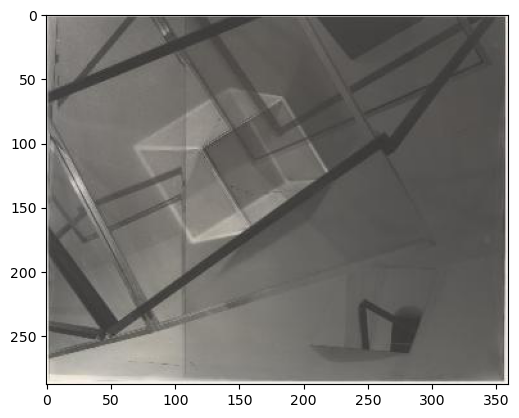

Image Index: 68
Primary Medium: photography
Medium: photo, gelatin silver print on paper
Representation: False
Representation Semi: True
Spatial Dimension: False


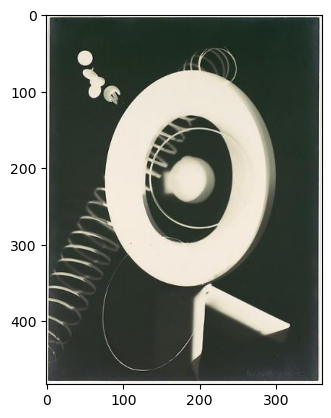

Image Index: 83
Primary Medium: photography
Medium: photo, gelatin silver print on paper
Representation: False
Representation Semi: True
Spatial Dimension: False


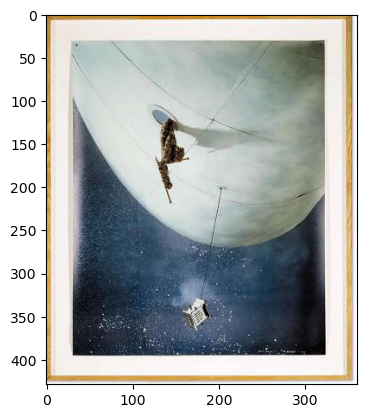

Image Index: 193
Primary Medium: photography
Medium: photo, photograph, color, Cibachrome print, on paper mounted onto board
Representation: False
Representation Semi: True
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 11
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


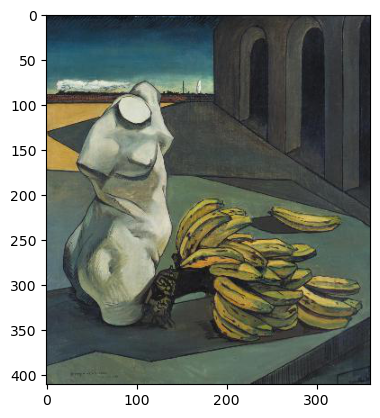

Image Index: 2
Primary Medium: painting
Medium: painting, oil on canvas
Representation: True
Representation Semi: False
Spatial Dimension: False


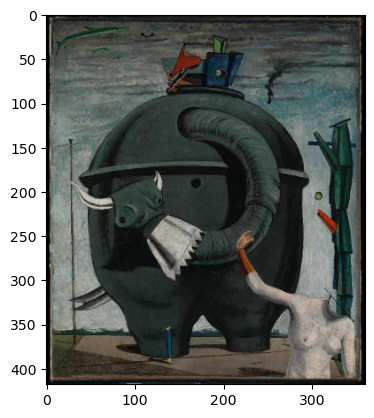

Image Index: 34
Primary Medium: painting
Medium: painting, oil on canvas
Representation: True
Representation Semi: False
Spatial Dimension: False


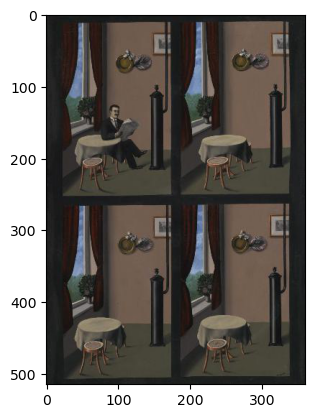

Image Index: 79
Primary Medium: painting
Medium: painting, oil on canvas
Representation: True
Representation Semi: False
Spatial Dimension: False


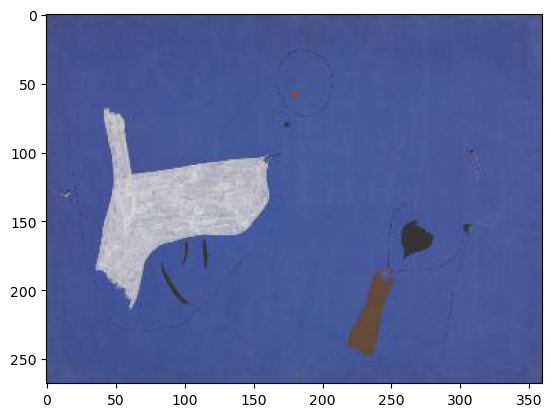

Image Index: 101
Primary Medium: painting
Medium: painting, tempera & oil on canvas
Representation: False
Representation Semi: False
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 12
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


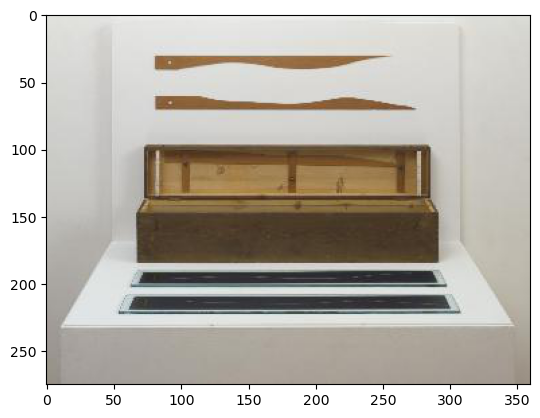

Image Index: 32
Primary Medium: sculpture
Medium: sculpture, wood, glass & paint on canvas
Representation: False
Representation Semi: False
Spatial Dimension: True


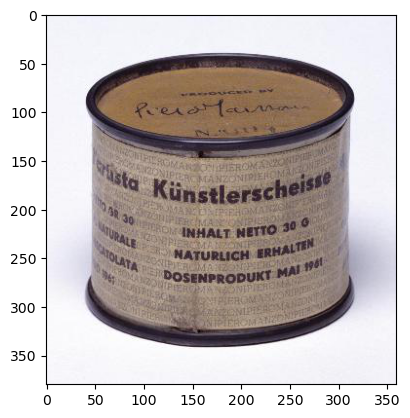

Image Index: 86
Primary Medium: sculpture
Medium: sculpture, tin can, printed paper & excrement
Representation: True
Representation Semi: False
Spatial Dimension: True


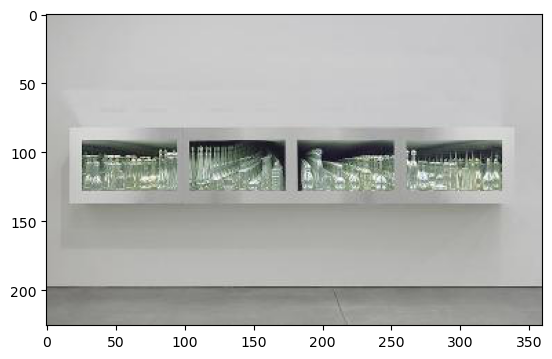

Image Index: 93
Primary Medium: sculpture
Medium: sculpture, handblown mirrored glass, display structure, transparent mirror, lighting
Representation: True
Representation Semi: False
Spatial Dimension: True


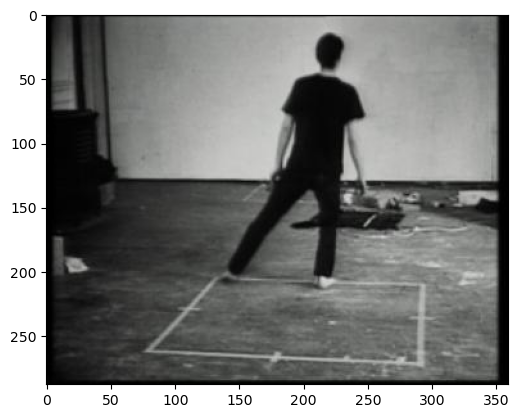

Image Index: 106
Primary Medium: video_film
Medium: video, 16 mm film transferred to video, b/w, sound
Representation: True
Representation Semi: False
Spatial Dimension: True

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 13
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


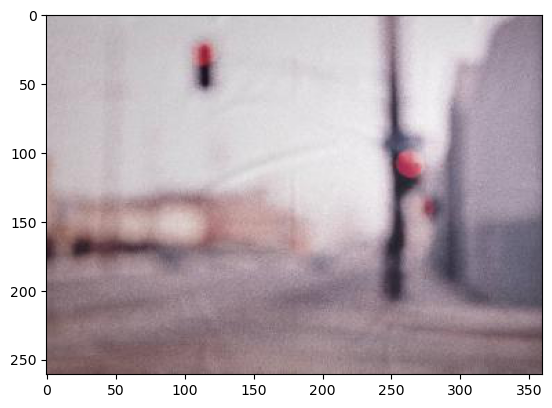

Image Index: 9
Primary Medium: photography
Medium: photo, digital print w/ acrylic on canvas
Representation: True
Representation Semi: False
Spatial Dimension: False


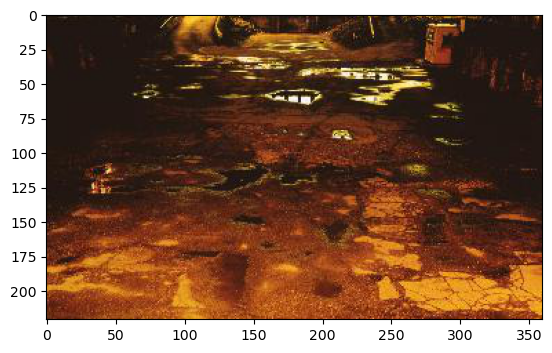

Image Index: 16
Primary Medium: photography
Medium: photo, paper mounted onto aluminium
Representation: True
Representation Semi: False
Spatial Dimension: False


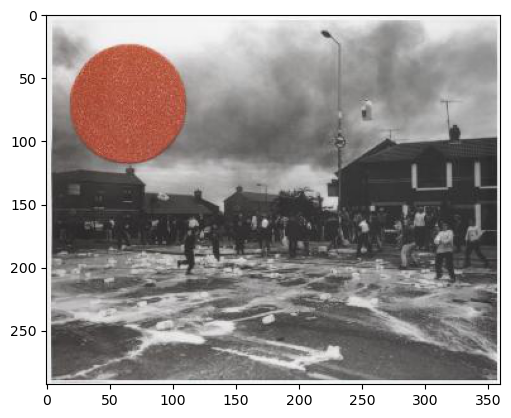

Image Index: 23
Primary Medium: photography
Medium: photo, digital print on paper
Representation: True
Representation Semi: False
Spatial Dimension: False


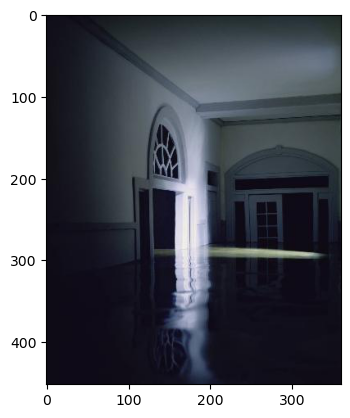

Image Index: 26
Primary Medium: photography
Medium: photo
Representation: True
Representation Semi: False
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 14
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


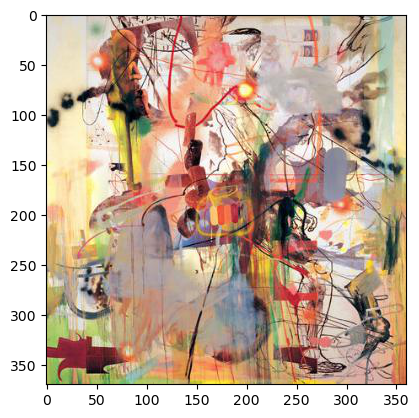

Image Index: 110
Primary Medium: painting
Medium: painting, mixed media on canvas
Representation: False
Representation Semi: True
Spatial Dimension: False


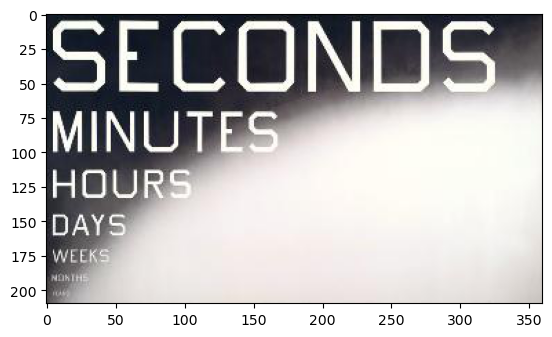

Image Index: 156
Primary Medium: painting
Medium: painting, acrylic on canvas
Representation: False
Representation Semi: True
Spatial Dimension: False


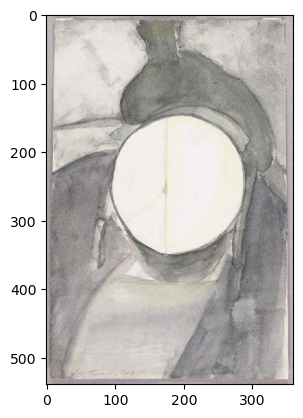

Image Index: 182
Primary Medium: painting
Medium: painting, watercolor on paper
Representation: False
Representation Semi: True
Spatial Dimension: False


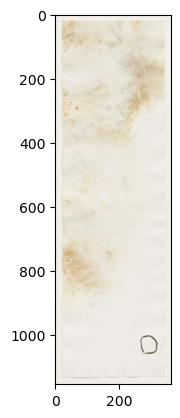

Image Index: 315
Primary Medium: painting
Medium: painting, soot & watercolor on paper
Representation: False
Representation Semi: True
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 15
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


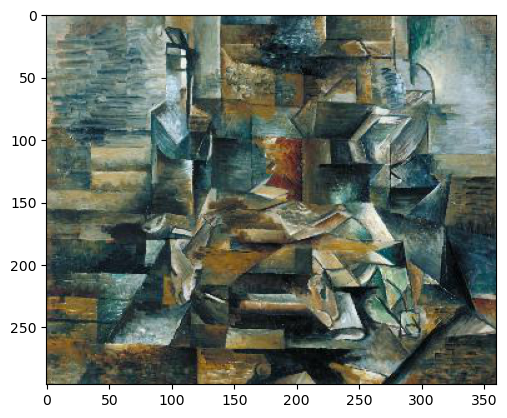

Image Index: 22
Primary Medium: painting
Medium: painting, oil on canvas
Representation: False
Representation Semi: True
Spatial Dimension: False


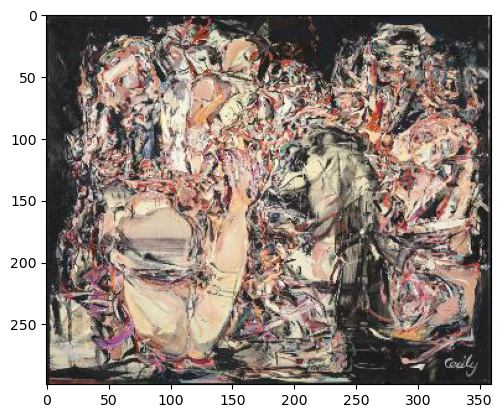

Image Index: 24
Primary Medium: painting
Medium: painting, oil on canvas
Representation: False
Representation Semi: True
Spatial Dimension: False


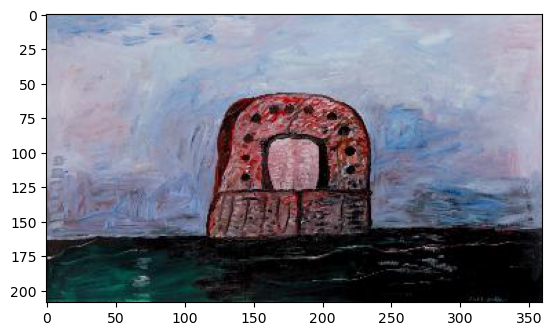

Image Index: 48
Primary Medium: painting
Medium: painting, oil on canvas
Representation: False
Representation Semi: True
Spatial Dimension: False


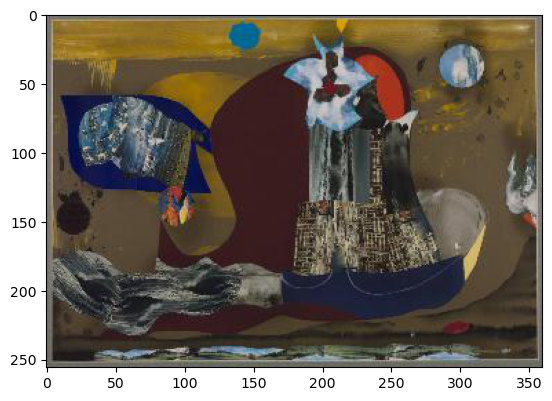

Image Index: 120
Primary Medium: painting
Medium: painting, gouache, graphite, ink & postcards on paper
Representation: False
Representation Semi: True
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 16
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


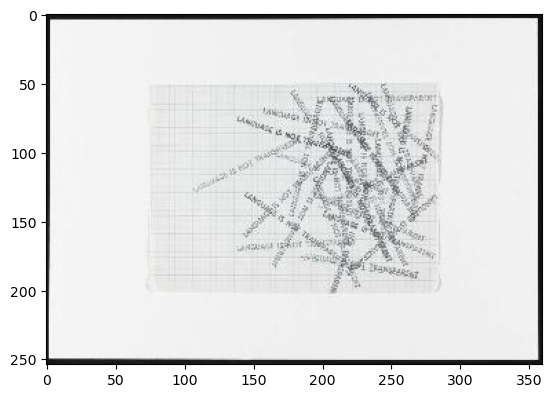

Image Index: 18
Primary Medium: drawing
Medium: drawing, ink on paper
Representation: False
Representation Semi: False
Spatial Dimension: False


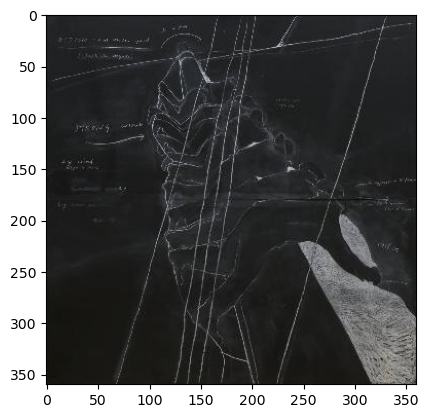

Image Index: 29
Primary Medium: drawing
Medium: drawing, chalk on blackboard
Representation: False
Representation Semi: True
Spatial Dimension: False


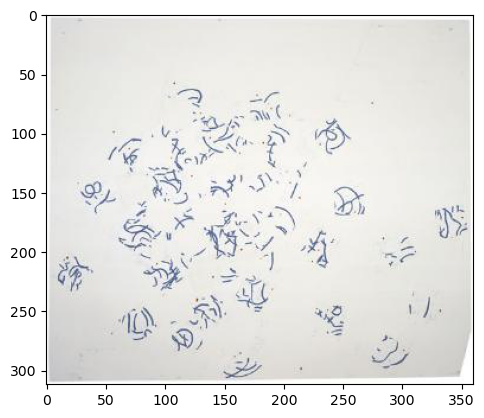

Image Index: 61
Primary Medium: drawing
Medium: drawing, blue and red pigment and varnish on paper
Representation: False
Representation Semi: False
Spatial Dimension: False


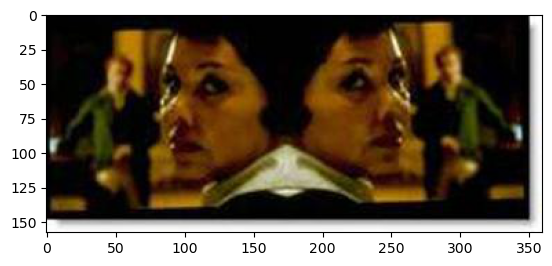

Image Index: 66
Primary Medium: video_film
Medium: video, 2 back projections, 7 mins
Representation: True
Representation Semi: False
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 17
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


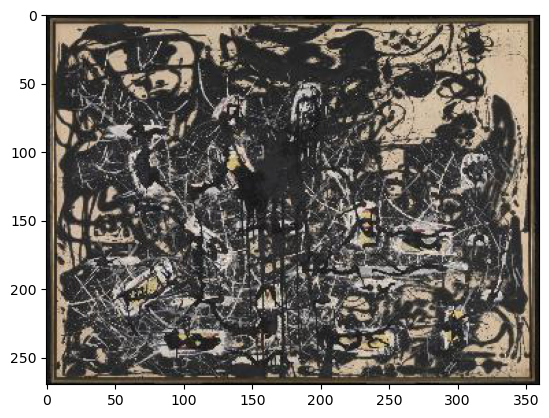

Image Index: 128
Primary Medium: painting
Medium: painting, oil on canvas
Representation: False
Representation Semi: False
Spatial Dimension: False


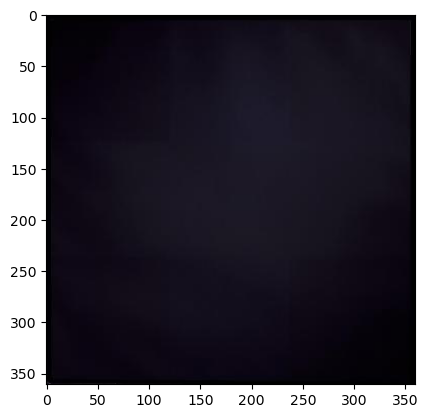

Image Index: 141
Primary Medium: painting
Medium: painting, oil on canvas
Representation: False
Representation Semi: False
Spatial Dimension: False


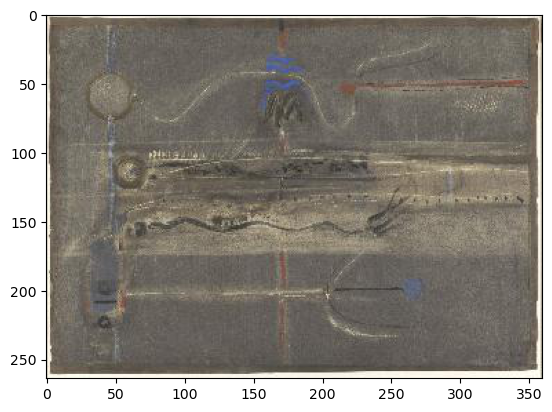

Image Index: 153
Primary Medium: painting
Medium: painting, watercolor & gouache on paper
Representation: False
Representation Semi: False
Spatial Dimension: False


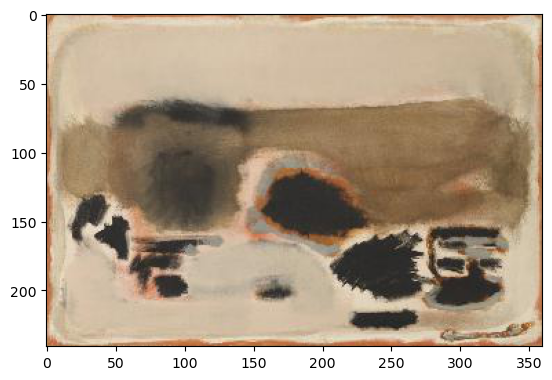

Image Index: 360
Primary Medium: painting
Medium: painting, oil on canvas
Representation: False
Representation Semi: False
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 18
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


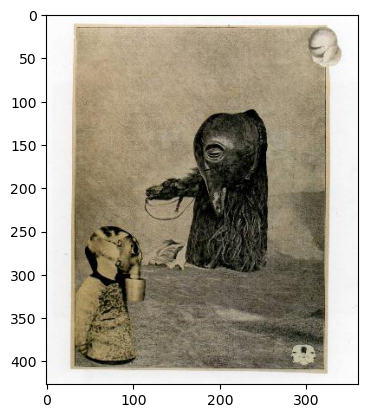

Image Index: 148
Primary Medium: print
Medium: print, lineblock prints & halftone prints on paper mounted onto paper
Representation: False
Representation Semi: True
Spatial Dimension: False


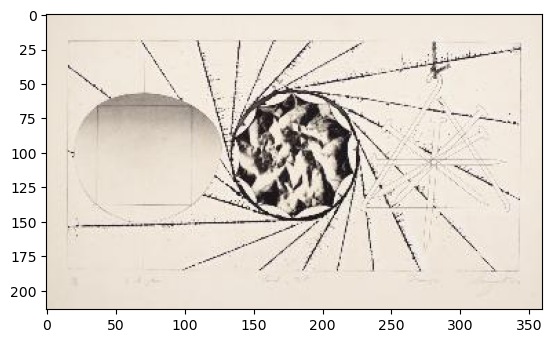

Image Index: 149
Primary Medium: print
Medium: print, etching, drypoint & aquatint on paper
Representation: False
Representation Semi: True
Spatial Dimension: False


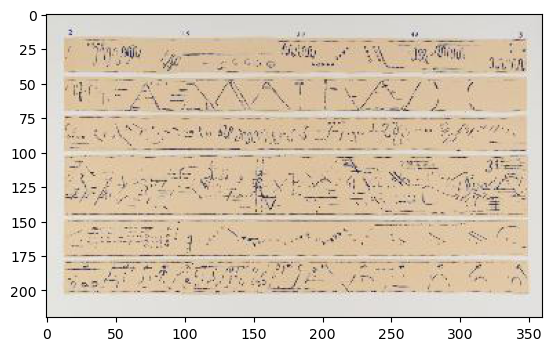

Image Index: 154
Primary Medium: print
Medium: print, screenprint on paper
Representation: False
Representation Semi: True
Spatial Dimension: False


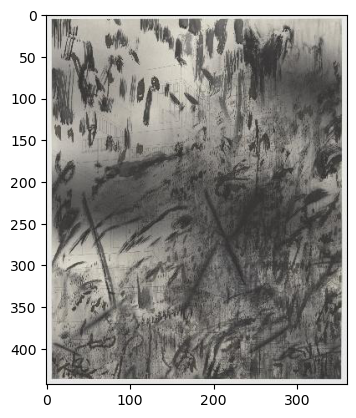

Image Index: 245
Primary Medium: print
Medium: print, photogravure & aquatint on six panels (twelve sheets)
Representation: False
Representation Semi: True
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 19
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


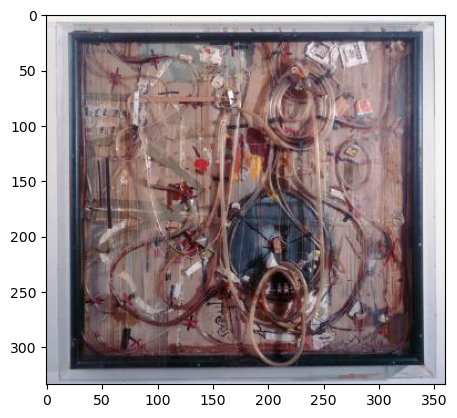

Image Index: 152
Primary Medium: sculpture
Medium: sculpture, toys, sweets, trinkets, printed matter, painting utensils, adhesive tape, tools, refuse, strips of wood & metal, glue on corrugated cardboard. Sour milk, fruit juice, cocoa, dead insects in plastic tubes, in wooden frame with openings for pouring in liquids
Representation: False
Representation Semi: True
Spatial Dimension: True


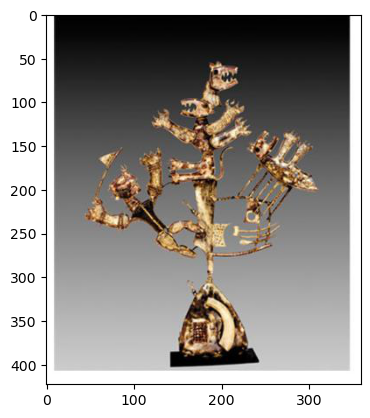

Image Index: 221
Primary Medium: sculpture
Medium: sculpture, copper & brass welded
Representation: False
Representation Semi: True
Spatial Dimension: True


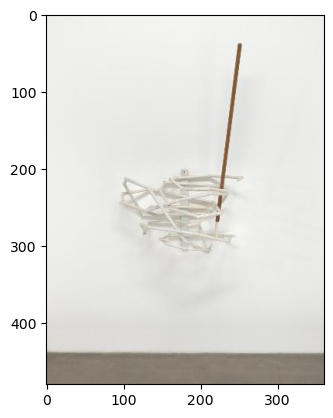

Image Index: 313
Primary Medium: sculpture
Medium: sculpture, wooden broomsticks w/ enamel paint mounted on formica laminate
Representation: False
Representation Semi: True
Spatial Dimension: True


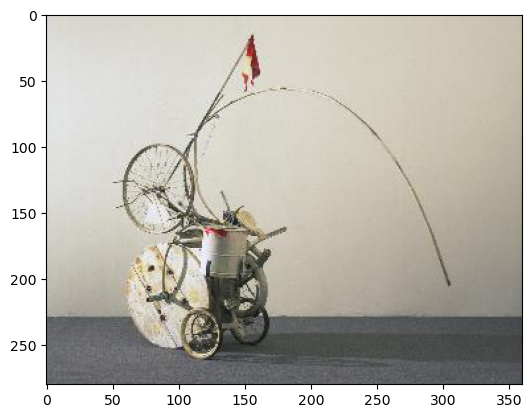

Image Index: 346
Primary Medium: sculpture
Medium: sculpture, painted metal, fabric, tape, wood, & rubber tires
Representation: False
Representation Semi: True
Spatial Dimension: True

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 20
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


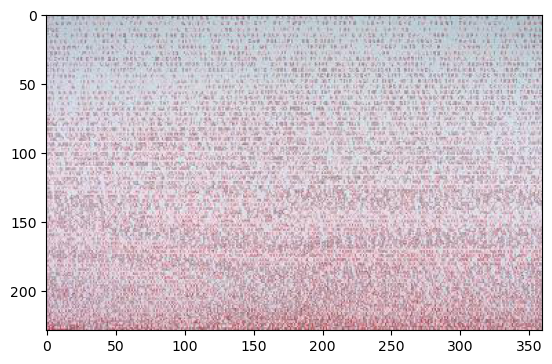

Image Index: 7
Primary Medium: painting
Medium: painting, marker pen, acrylic on canvas
Representation: False
Representation Semi: False
Spatial Dimension: False


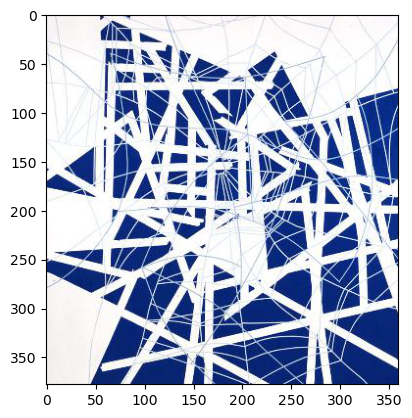

Image Index: 56
Primary Medium: painting
Medium: painting, acrylic on canvas
Representation: False
Representation Semi: False
Spatial Dimension: False


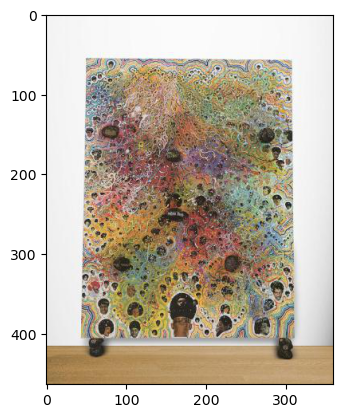

Image Index: 111
Primary Medium: painting
Medium: painting, oil, paper collage, glitter, polyester resin, map pins & elephant dung on linen
Representation: True
Representation Semi: False
Spatial Dimension: False


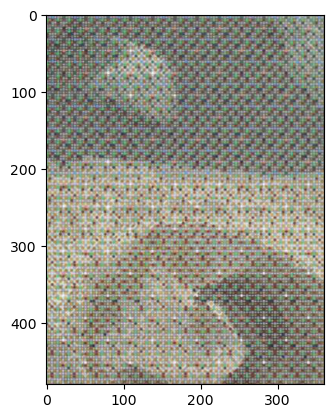

Image Index: 115
Primary Medium: painting
Medium: painting, acrylic on canvas
Representation: False
Representation Semi: False
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 21
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


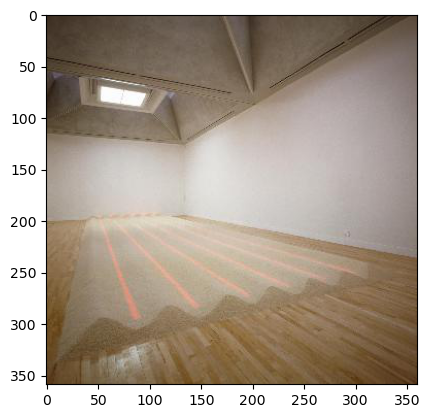

Image Index: 122
Primary Medium: installation
Medium: installation, rice & neon tubes
Representation: False
Representation Semi: True
Spatial Dimension: True


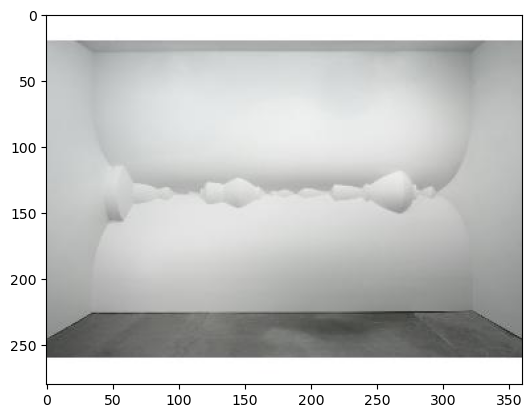

Image Index: 209
Primary Medium: installation
Medium: installation, MDF & acrylic paint
Representation: False
Representation Semi: True
Spatial Dimension: True


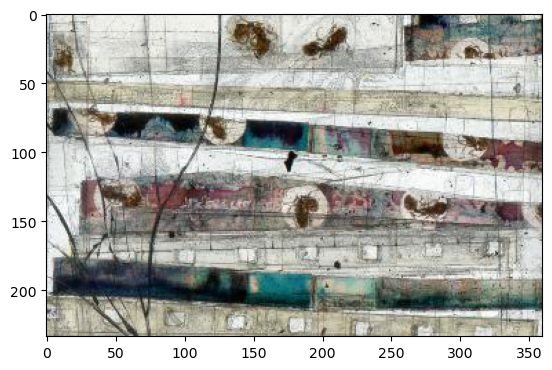

Image Index: 268
Primary Medium: installation
Medium: installation, handmade slide, projected in pairs
Representation: False
Representation Semi: True
Spatial Dimension: False

* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 22
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 


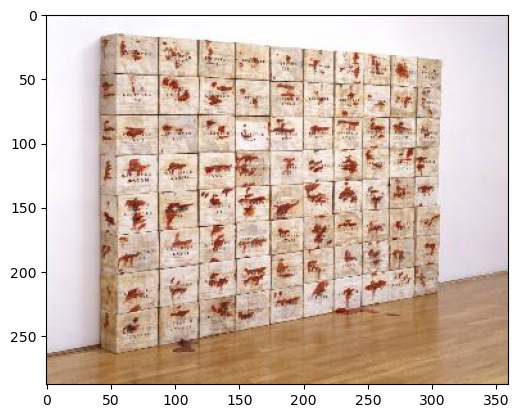

Image Index: 25
Primary Medium: installation
Medium: installation, cardboard boxes, gauze, polyvinyl acetate
Representation: False
Representation Semi: False
Spatial Dimension: True


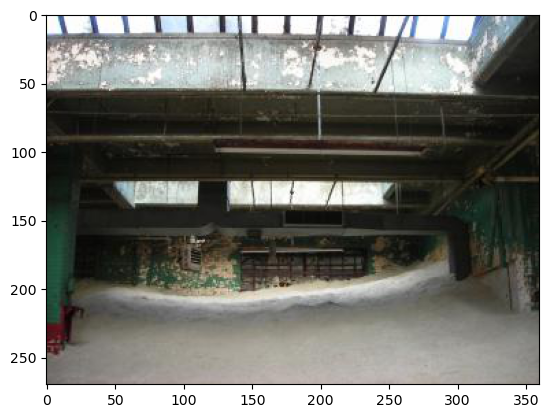

Image Index: 107
Primary Medium: installation
Medium: installation, sand
Representation: True
Representation Semi: False
Spatial Dimension: True


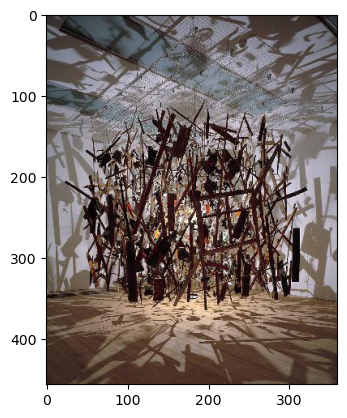

In [ ]:
import matplotlib.pyplot as plt
from skimage import io

# Loop through each cluster
for i in range(0, max(km.labels_)+1):
    print("\n* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * ")
    print("Images in cluster: " + str(i))
    print("* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * ")
    
    # Initialize a counter for images displayed per cluster
    image_displayed = 0
    
    for j in range(0, len(km.labels_)):
        if km.labels_[j] == i:
            if image_displayed < 4:  # Set the limit of images per cluster
                image_path = 'img_small/' + str(j+2) + '_small.jpg'
                img = io.imread(image_path)
                plt.imshow(img)
                plt.show()
                print("Image Index:", str(j+2))
                # Optional: Uncomment these lines if you want to print additional details
                # print("Art Movement:", data.loc[j, 'art_movement'])
                # print("Country:", data.loc[j, 'country_of_origin'])
                print("Primary Medium:", data.loc[j, 'primary_medium'])
                print("Medium:", data.loc[j, 'medium'])
                print("Representation:", data.loc[j, 'representation'])
                print("Representation Semi:", data.loc[j, 'representation_semi'])
                print("Spatial Dimension:", data.loc[j, 'spatial_dimension'])
                
                image_displayed += 1  # Increment the counter

            else:
                break  # Stop showing more images after the limit
